# Final Project - Training Data

This Notebook loads and displays some examples from the training dataset.

The training dataset contains a total of 3717 samples. All groups have been given the same training dataset and the final report will be graded based on the performance on this training data.

* You should expect the test dataset to have the same format as the training data: $270,000\times M$ numpy array, where $M$ is the number of test samples.
* This means that *any* pre-processing applied in the training data should also be applied in the test data.

In [3]:
import matplotlib.pyplot as plt
%matplotlib inline
plt.style.use('bmh')

import tensorflow as tf
from tensorflow import keras

2023-04-24 22:26:45.706289: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  SSE4.1 SSE4.2
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [4]:
import numpy as np
import numpy.random as npr
import matplotlib.pyplot as plt
%matplotlib inline
plt.style.use('bmh')

In [5]:
# Loading Data
data_train = np.load('data_train.npy')
labels_train = np.load('labels_train.npy')

print(data_train.shape, labels_train.shape)

(270000, 3717) (3717,)


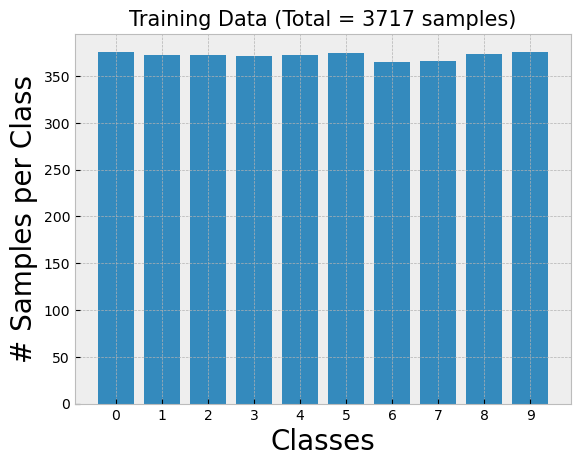

In [3]:
# Counting number samples per class
vals, counts = np.unique(labels_train, return_counts=True)

plt.bar(vals, counts)
plt.xticks(range(10),range(10))
plt.xlabel('Classes',size=20)
plt.ylabel('# Samples per Class', size=20)
plt.title('Training Data (Total = '+str(data_train.shape[1])+' samples)',size=15);

In [4]:
# Labels Integer Encoding

labels_names = ['Nike',
                'Adidas',
                'Ford',
                'Honda',
                'General Mills',
                'Unilever',
                "McDonald's",
                'KFC',
                'Gators',
                '3M']

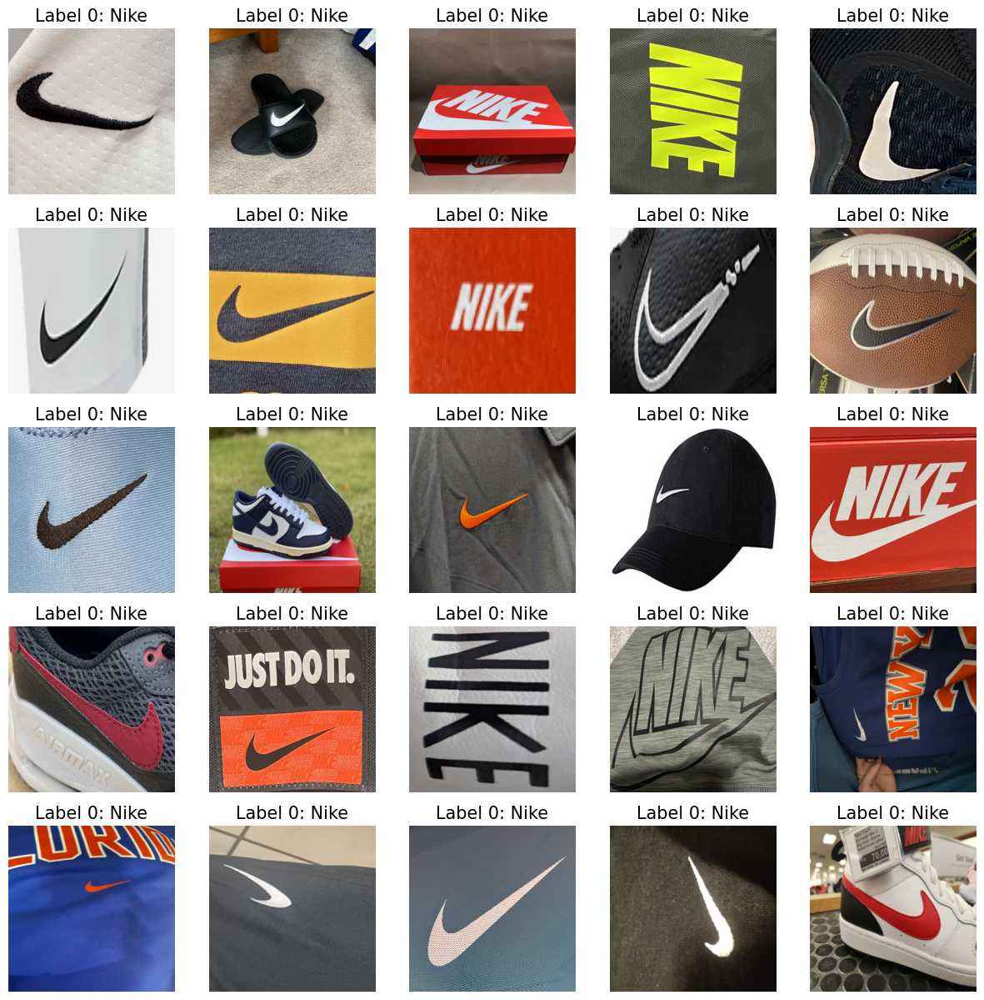

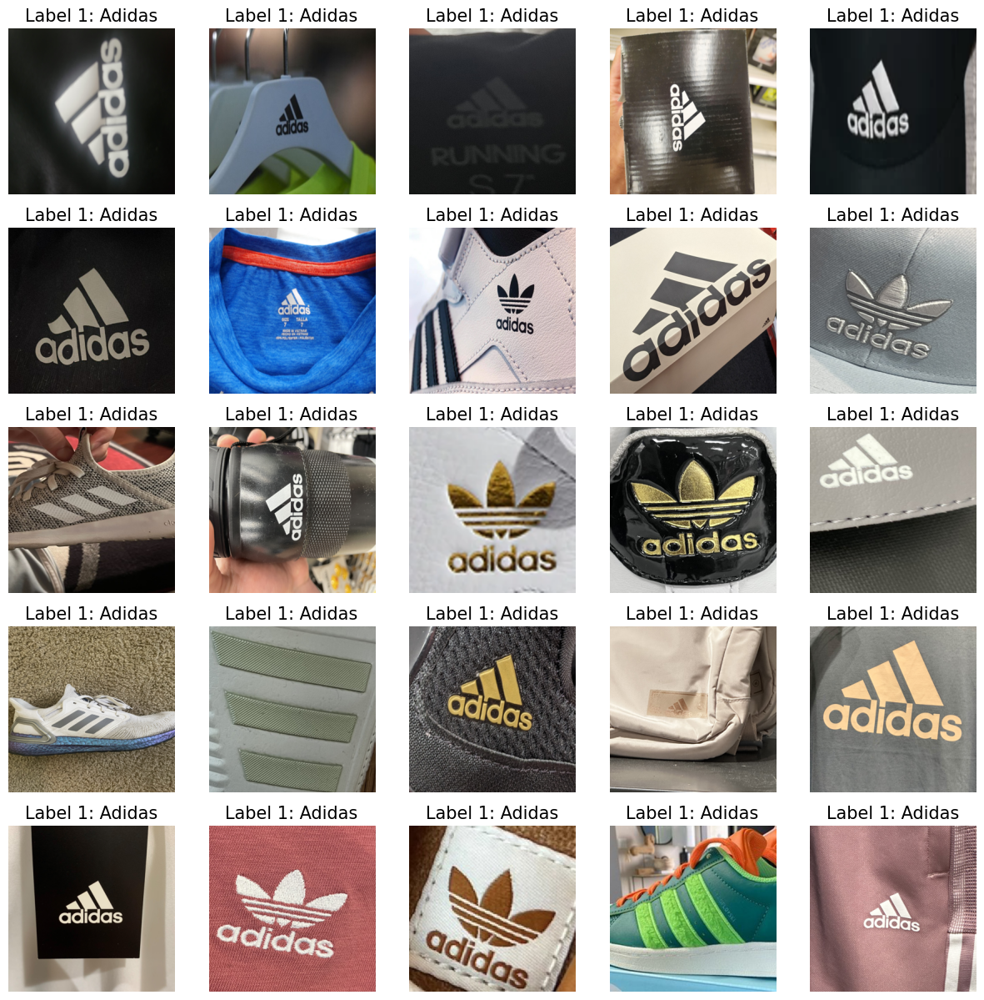

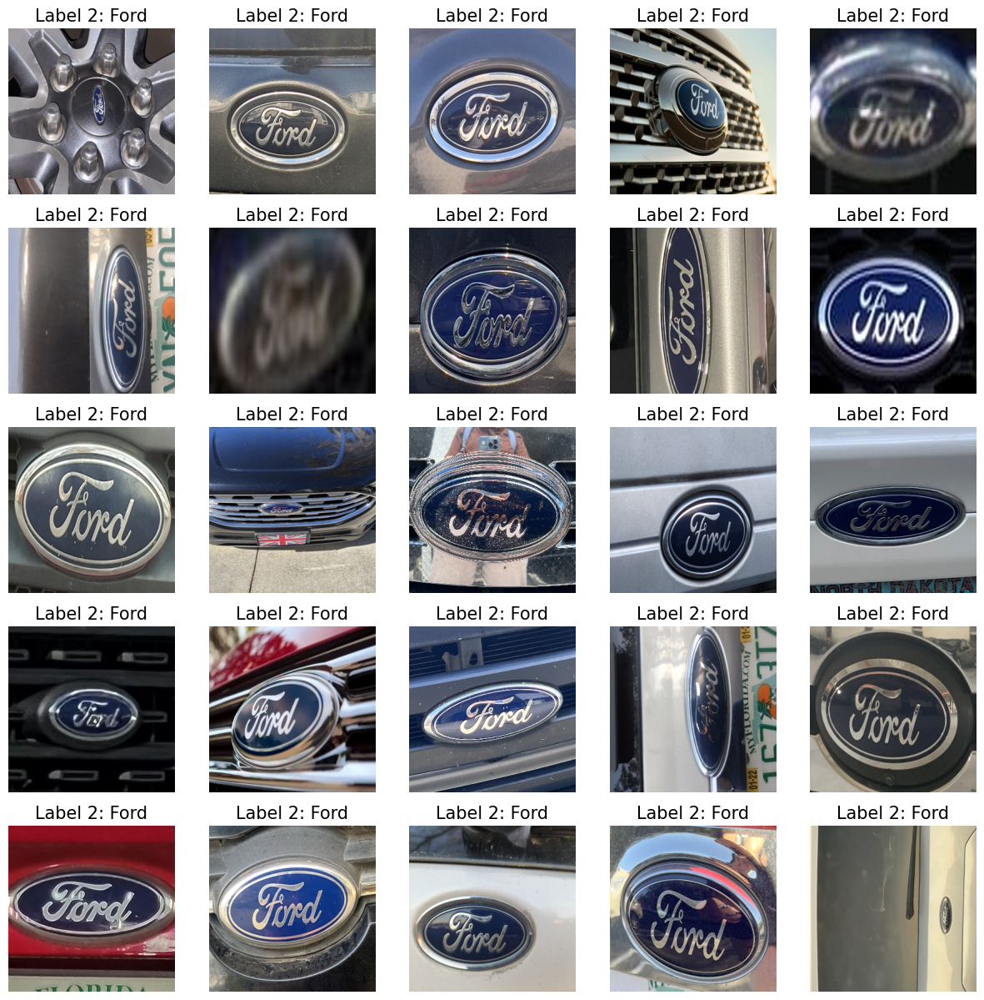

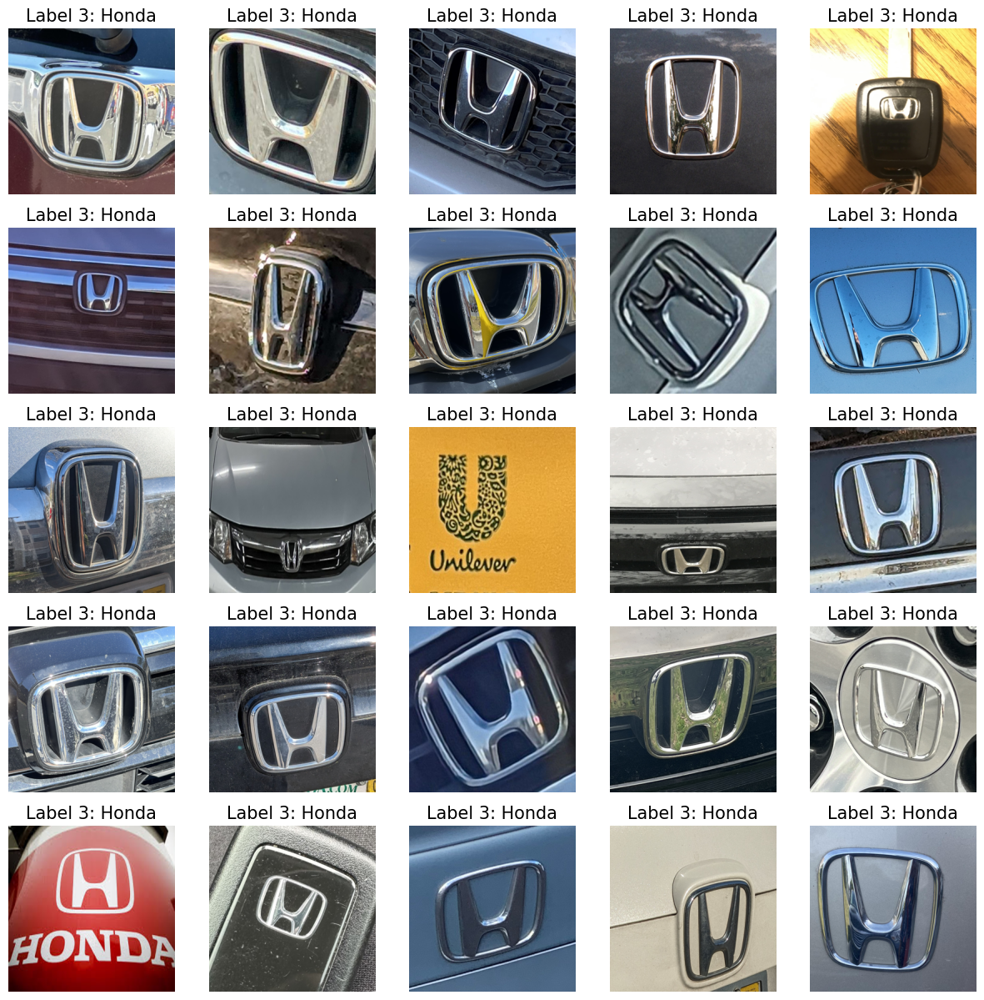

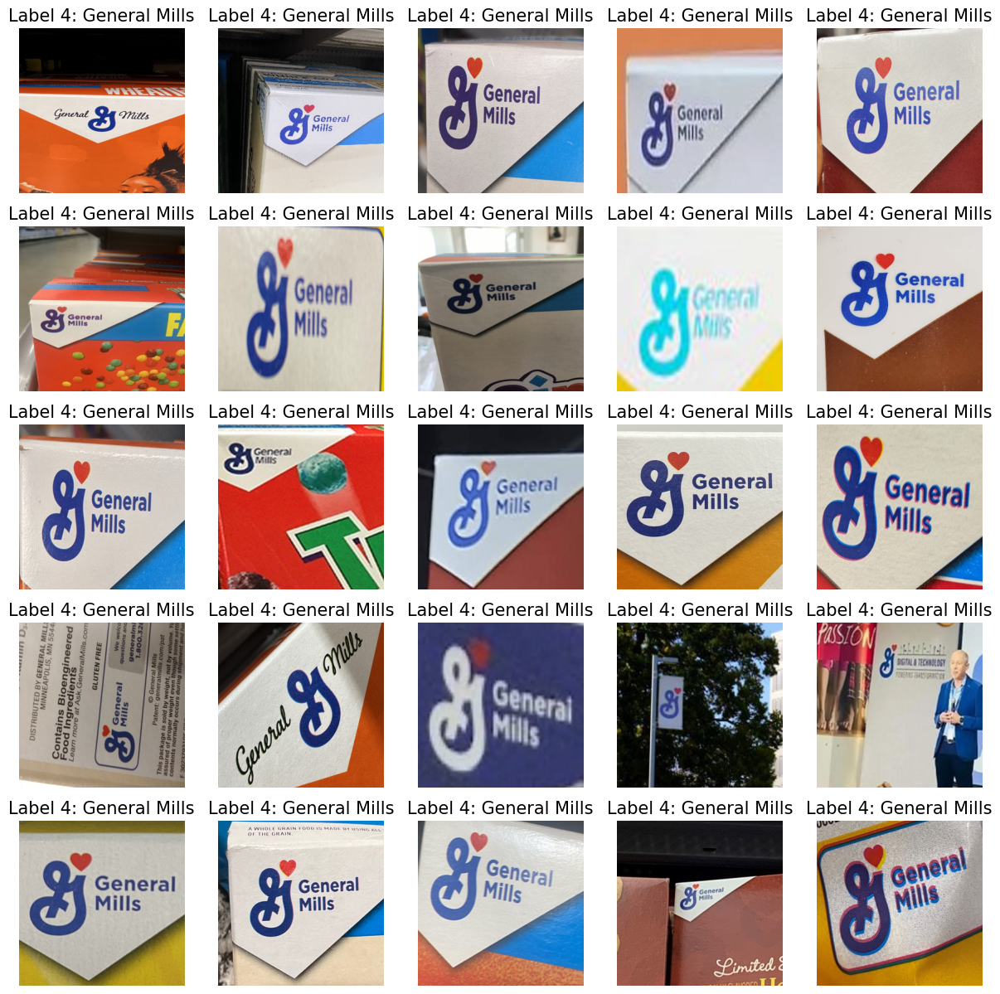

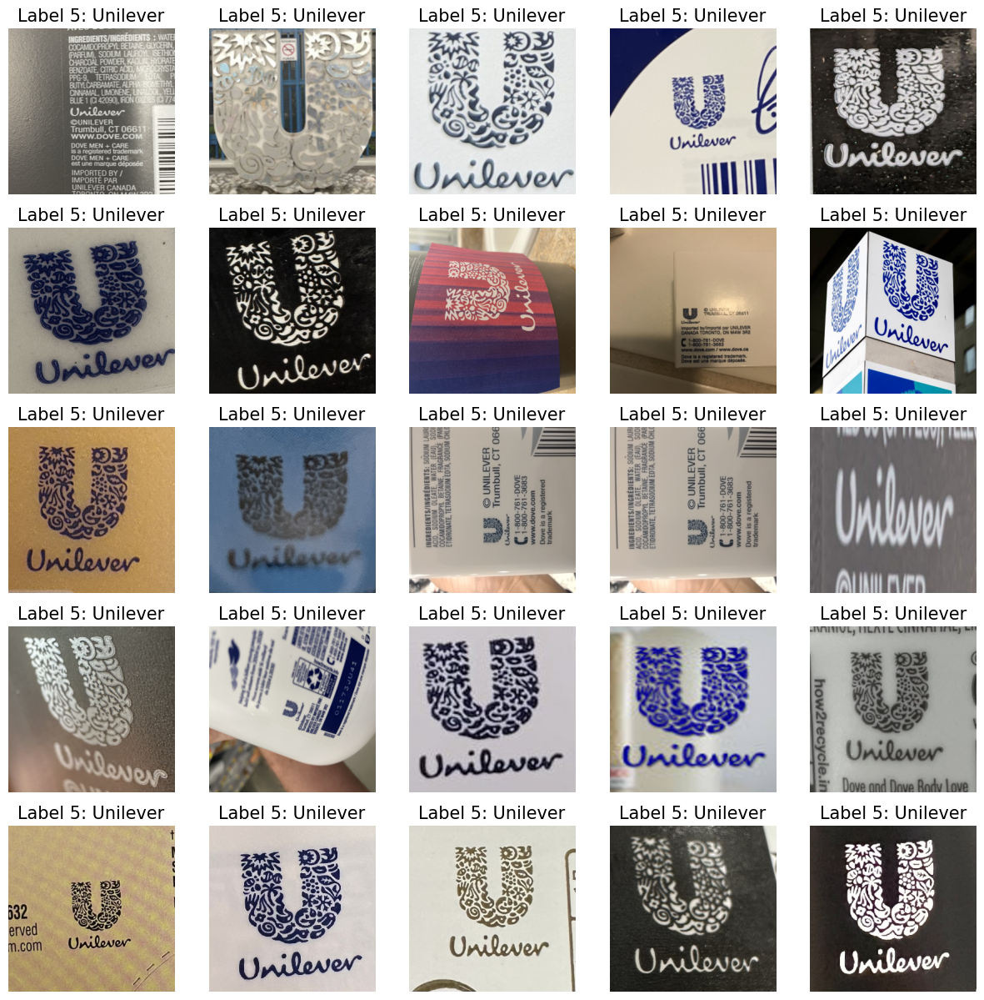

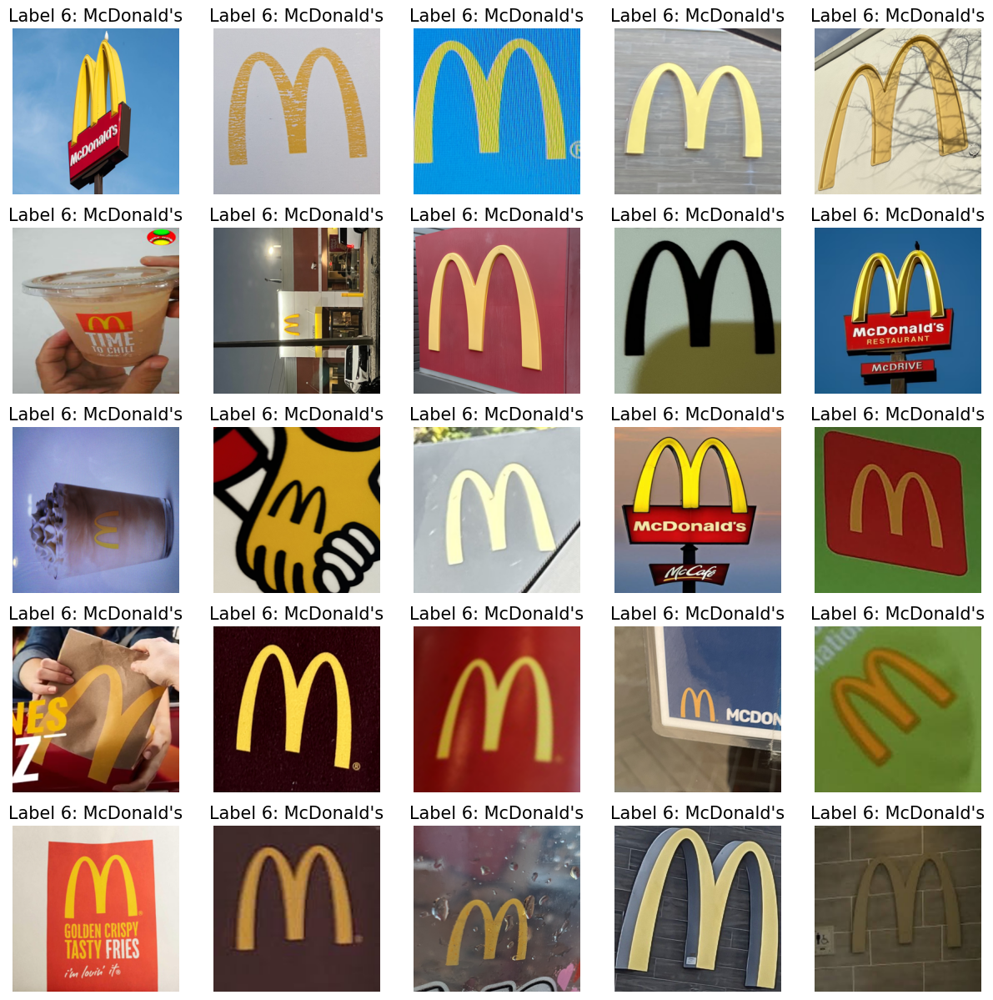

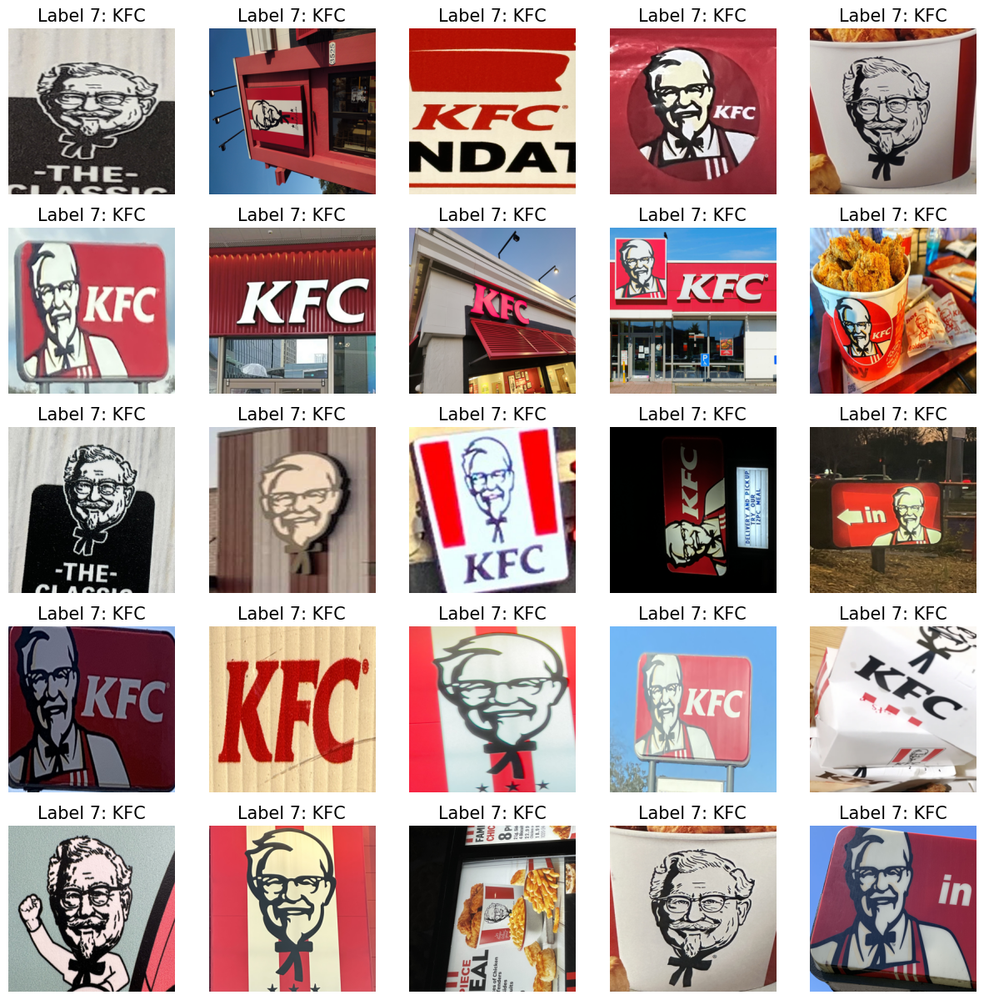

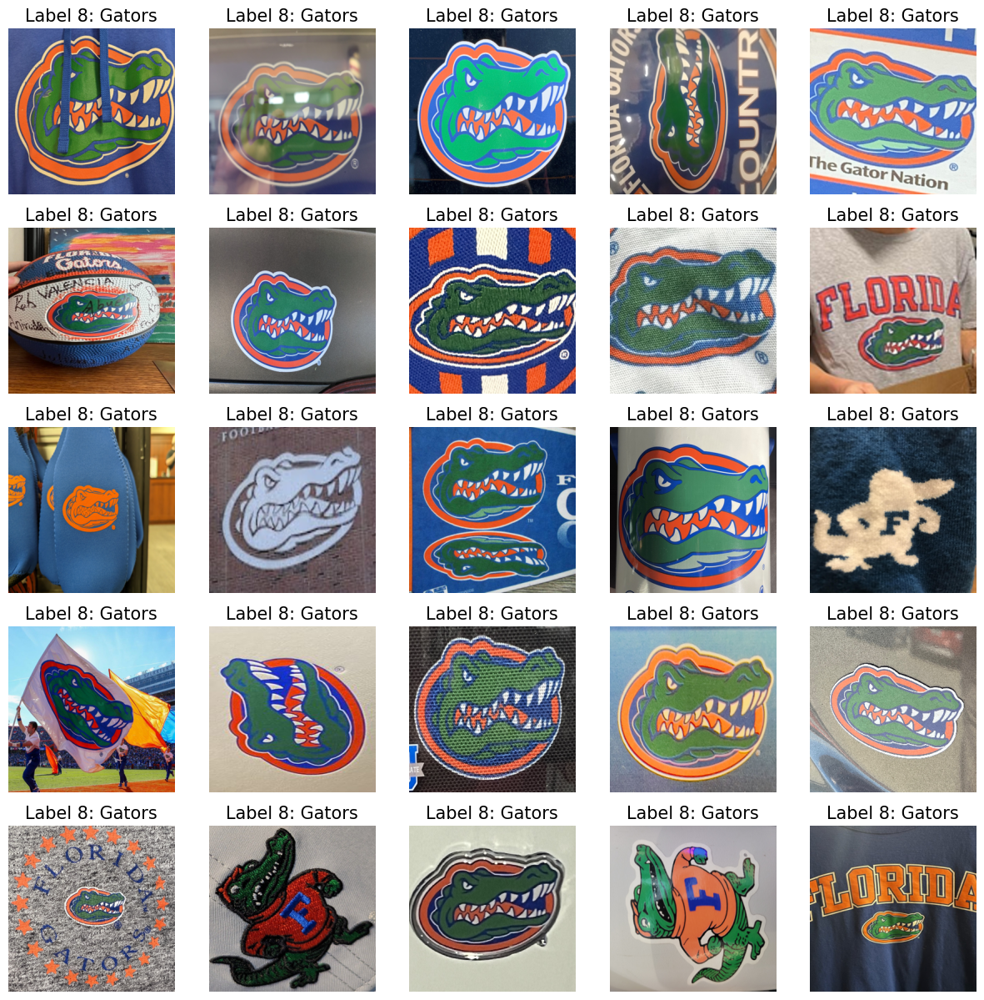

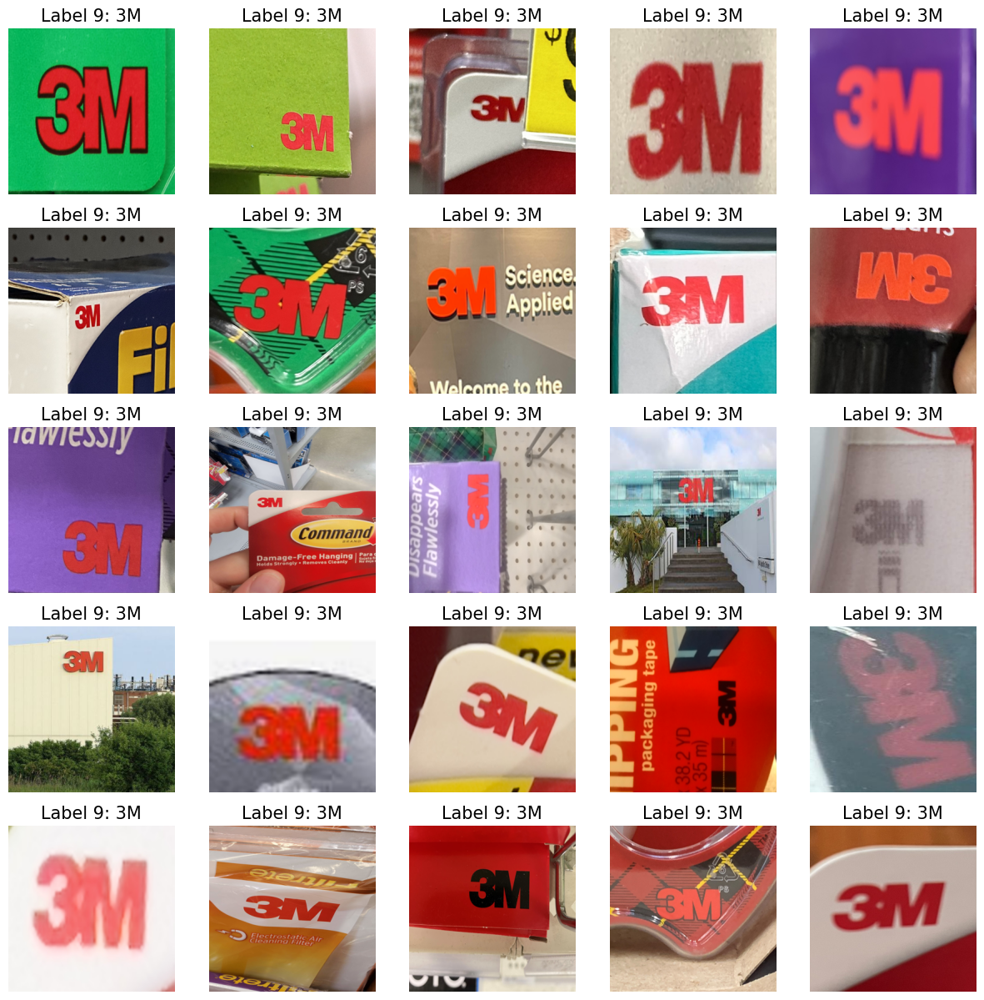

In [5]:
# Displaying some examples per class

for i in range(0,10):
    rnd_sample = npr.permutation(np.where(labels_train==i)[0])
    fig=plt.figure(figsize=(15,15))
    for j in range(25):
        fig.add_subplot(5,5,j+1)
        plt.imshow(data_train[:,rnd_sample[j]].reshape((300,300,3)))
        label_idx = int(labels_train[rnd_sample[j]])
        plt.axis('off');plt.title('Label '+str(label_idx)+': '+labels_names[label_idx],size=15)
    plt.show()
    print('\n\n')

In [7]:
X_train_full = np.load('data_train.npy').T
t_train_full = np.load('labels_train.npy')

X_train_full.shape, t_train_full.shape

((3717, 270000), (3717,))

In [8]:
from sklearn.model_selection import train_test_split

# Training and Test sets
X_training, X_test, t_training, t_test = train_test_split(X_train_full, 
                                                  t_train_full, 
                                                  shuffle=True,
                                                  stratify=t_train_full,
                                                  test_size=0.15)
# Train and validation sets
X_train, X_val, t_train, t_val = train_test_split(X_training, 
                                                  t_training, 
                                                  shuffle=True,
                                                  stratify=t_training,
                                                  test_size=0.2)

X_training.shape, t_training.shape, X_train.shape, t_train.shape, X_val.shape, t_val.shape

((3159, 270000), (3159,), (2527, 270000), (2527,), (632, 270000), (632,))

In [9]:
X_training = X_training.reshape(X_training.shape[0], 300, 300, 3)/255.0

X_train = X_train.reshape(X_train.shape[0], 300, 300, 3)/255.0

X_val = X_val.reshape(X_val.shape[0], 300, 300, 3)/255.0

X_test = X_test.reshape(X_test.shape[0], 300, 300, 3)/255.0

X_train.shape

(2527, 300, 300, 3)

In [10]:
# Labels Integer Encoding

class_names = ['Nike',
                'Adidas',
                'Ford',
                'Honda',
                'General Mills',
                'Unilever',
                "McDonald's",
                'KFC',
                'Gators',
                '3M']

In [11]:
model = keras.models.Sequential([
    keras.layers.Conv2D(64, 7, activation='relu', padding='same', input_shape=[300,300,3]), 
    keras.layers.MaxPooling2D(2), 
    keras.layers.Conv2D(128, 3, activation='relu', padding='same'), 
    keras.layers.MaxPooling2D(2),
    keras.layers.Flatten(),
#     keras.layers.Dense(150, activation='relu')
    keras.layers.Dense(64, activation='relu'),
    keras.layers.Dense(10, activation='softmax')
])

model.compile(loss=keras.losses.SparseCategoricalCrossentropy(),
             optimizer=keras.optimizers.Adam(learning_rate=0.01),
             metrics=['accuracy'])

In [ ]:
model.fit(X_train, t_train, epochs=4, batch_size=32,
          validation_data=(X_val, t_val),
         callbacks=[tf.keras.callbacks.EarlyStopping(patience=10)])

# In practice, you would run for a few more epochs.
# As well as perform the necessary hyperparameter tuning.

In [6]:
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import MinMaxScaler
from sklearn.naive_bayes import GaussianNB
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.model_selection import GridSearchCV, train_test_split
from sklearn.datasets import load_digits
from sklearn.metrics import accuracy_score, f1_score, confusion_matrix

In [7]:
X = np.load('data_train.npy').T # training data
t = np.load('labels_train.npy') # target values

In [15]:
X_train, X_test, y_train, y_test = train_test_split(X, t, test_size=0.2, random_state=42)


In [16]:


# Set up a pipelines:  Naive Bayes Classifier
nb_pipeline = Pipeline([
    ('MinMaxScaler', MinMaxScaler()),
    ('NaiveBayes_Classifier', GaussianNB())
])

# Logistic Regression
lr_pipeline = Pipeline([
    ('MinMaxScaler', MinMaxScaler()),
    ('Logistic_Regression', LogisticRegression())
])

# soft-margin SVM with RBF kernel
rbf_svm_pipeline = Pipeline([
    ('MinMaxScaler', MinMaxScaler()),
    ('SVM_RBF', SVC(kernel='rbf'))
])

# soft-margin SVM with polynomial 
poly_svm_pipeline = Pipeline([
    ('MinMaxScaler', MinMaxScaler()),
    ('SVM_pol', SVC(kernel='poly'))
])



# Hyperparameters to tune 
nb_params = {'NaiveBayes_Classifier__var_smoothing': [1e-9, 1e-9]}

lr_params = {'Logistic_Regression__C': [0.1, 1, 10],
              'Logistic_Regression__max_iter' : [1000, 10000] }

rbf_svm_params = {'SVM_RBF__C': [0.1, 1, 10], 'SVM_RBF__gamma': [0.1, 0.01]}

poly_svm_params = {'SVM_pol__C': [0.1, 1, 10], 'SVM_pol__degree': [2, 3, 4, 5]}



pipelines = [nb_pipeline, lr_pipeline, rbf_svm_pipeline, poly_svm_pipeline]
params = [nb_params, lr_params, rbf_svm_params, poly_svm_params]



# Hyperparameter tuning and result : 
for pipeline, param in zip(pipelines, params):
    grid_search = GridSearchCV(pipeline, param_grid=param, cv=4)
    grid_search.fit(X_train, y_train)
    classifier = grid_search.best_estimator_
    predict = classifier.predict(X_test)
    score = f1_score (y_test, predict, average='weighted')
    cmatrix = confusion_matrix(y_test, predict)
    accuracy = accuracy_score(y_test, predict)
    print('F1 Score for', pipeline.named_steps.keys() , "is : ", score,"Accuracy is : ",accuracy,'and confusion matrix is: \n', cmatrix,"\n")



F1 Score for dict_keys(['MinMaxScaler', 'NaiveBayes_Classifier']) is :  0.2895531430846701 Accuracy is :  0.29973118279569894 and confusion matrix is: 
 [[ 4  3  5 15 11 12 10  4  4  3]
 [10 10  5 19 19  9  0  2  2  0]
 [ 1  7 25 20  6 16  0  1  2  0]
 [ 2  5 13 41  5  9  1  1  4  0]
 [ 2 10  1  2 46  9  2  1  0  1]
 [ 0  3  5  9 27 16  7  2  8  2]
 [ 3  3  2  7 12  9 23  0  7  1]
 [10  2  2 10 10  9  5 18  4  0]
 [ 6  4  9  8  2 13  1  3 26  4]
 [ 6  4  4  5 14  9  9  2  5 14]] 



KeyboardInterrupt: 

---